<a href="https://colab.research.google.com/github/ThaoHuyen1856/CNN/blob/main/hoadatrain.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import files
files.upload()
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json


In [ ]:
!kaggle datasets download lucifierx/face-shape-classification


Dataset URL: https://www.kaggle.com/datasets/alxmamaev/flowers-recognition
License(s): unknown
 93% 208M/225M [00:01<00:00, 171MB/s]
100% 225M/225M [00:01<00:00, 173MB/s]
Archive:  flowers-recognition.zip
  inflating: flowers_data/flowers/daisy/100080576_f52e8ee070_n.jpg  
  inflating: flowers_data/flowers/daisy/10140303196_b88d3d6cec.jpg  
  inflating: flowers_data/flowers/daisy/10172379554_b296050f82_n.jpg  
  inflating: flowers_data/flowers/daisy/10172567486_2748826a8b.jpg  
  inflating: flowers_data/flowers/daisy/10172636503_21bededa75_n.jpg  
  inflating: flowers_data/flowers/daisy/102841525_bd6628ae3c.jpg  
  inflating: flowers_data/flowers/daisy/10300722094_28fa978807_n.jpg  
  inflating: flowers_data/flowers/daisy/1031799732_e7f4008c03.jpg  
  inflating: flowers_data/flowers/daisy/10391248763_1d16681106_n.jpg  
  inflating: flowers_data/flowers/daisy/10437754174_22ec990b77_m.jpg  
  inflating: flowers_data/flowers/daisy/10437770546_8bb6f7bdd3_m.jpg  
  inflating: flowers_data/f

In [ ]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Dense, Activation
from sklearn.preprocessing import StandardScaler
from keras.utils import to_categorical
data= "/content/drive/MyDrive/flowers"
img_size=(64,64)
x, y= [], []
for label, folder in enumerate(["daisy", "dandelion", "rose", "sunflower", "tulip"]):
  folder_path= os.path.join(data, folder)
  for file_name in os.listdir(folder_path):
    if file_name.endswith(".jpg"):
      img= cv2.imread(os.path.join(folder_path, file_name))
      img= cv2.resize(img, img_size)
      x.append(img)
      y.append(label)
x=np.array(x)
y=np.array(y)
(x_train, x_test, y_train, y_test)= train_test_split(x, y, test_size=0.2, random_state=42)
x_train=x_train.reshape(x_train.shape[0], 64*64*3)
x_train=x_train.astype('float32')/255
x_test=x_test.reshape(x_test.shape[0], 64*64*3)
x_test=x_test.astype('float32')/255
y_train= to_categorical(y_train)
y_test= to_categorical(y_test)

In [ ]:
model= Sequential([Dense(3000, activation='relu', input_shape=(64*64*3,)),
                   Dense(5, activation='softmax')])
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit(x_train, y_train, epochs=15, batch_size=32, validation_data=(x_test, y_test))
loss, acc = model.evaluate(x_test, y_test)
print(f"Accuracy: {acc*100:.2f}%")
model.save("/content/hoadatrain.h5")

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/15
108/108 ━━━━━━━━━━━━━━━━━━━━ 89s 812ms/step - accuracy: 0.3103 - loss: 12.5703 - val_accuracy: 0.3657 - val_loss: 1.6585
Epoch 2/15
108/108 ━━━━━━━━━━━━━━━━━━━━ 156s 947ms/step - accuracy: 0.4229 - loss: 1.4040 - val_accuracy: 0.4051 - val_loss: 1.3216
Epoch 3/15
108/108 ━━━━━━━━━━━━━━━━━━━━ 92s 857ms/step - accuracy: 0.4824 - loss: 1.2877 - val_accuracy: 0.4039 - val_loss: 1.4687
Epoch 4/15
108/108 ━━━━━━━━━━━━━━━━━━━━ 142s 858ms/step - accuracy: 0.5143 - loss: 1.1585 - val_accuracy: 0.4086 - val_loss: 1.3698
Epoch 5/15
108/108 ━━━━━━━━━━━━━━━━━━━━ 143s 873ms/step - accuracy: 0.5188 - loss: 1.1428 - val_accuracy: 0.4676 - val_loss: 1.2911
Epoch 6/15
108/108 ━━━━━━━━━━━━━━━━━━━━ 95s 881ms/step - accuracy: 0.5441 - loss: 1.0968 - val_accuracy: 0.4560 - val_loss: 1.3440
Epoch 7/15
108/108 ━━━━━━━━━━━━━━━━━━━━ 153s 986ms/step - accuracy: 0.5898 - loss: 1.0274 - val_accuracy: 0.4595 - val_loss: 1.2759
Epoch 8/15
108/108 ━━━━━━━━━━━━━━━━━━━━ 92s 856ms/step - accuracy: 0.5846 - lo

Accuracy: 49.31%


In [ ]:
model.save("/content/hoadatrain.h5")

In [ ]:
import os
print(os.path.exists('/content/hoadatrain.h5'))

True


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


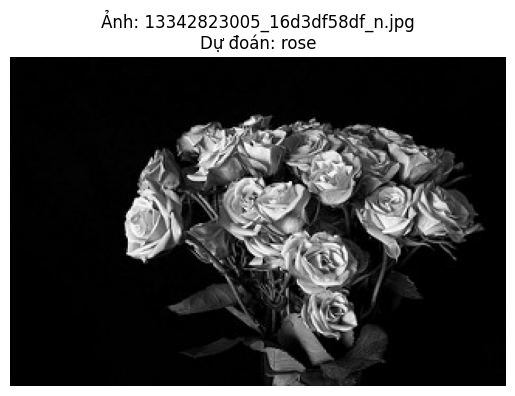

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


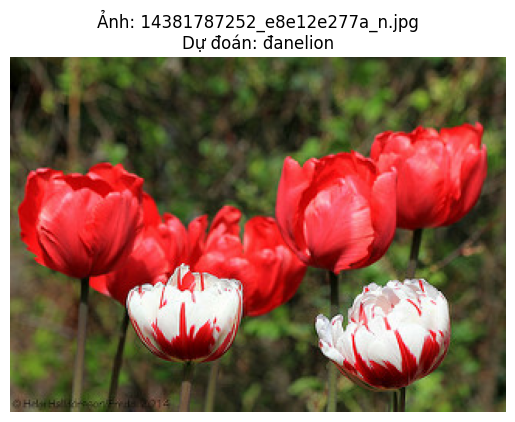

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


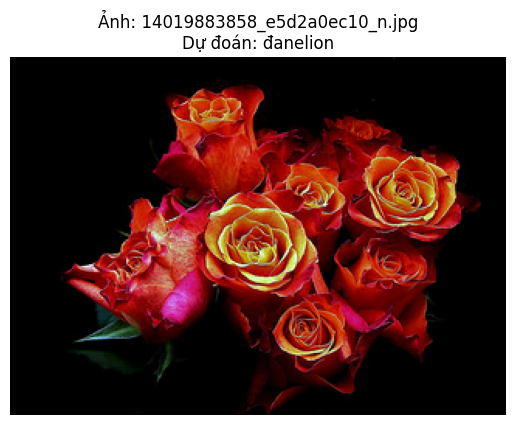

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


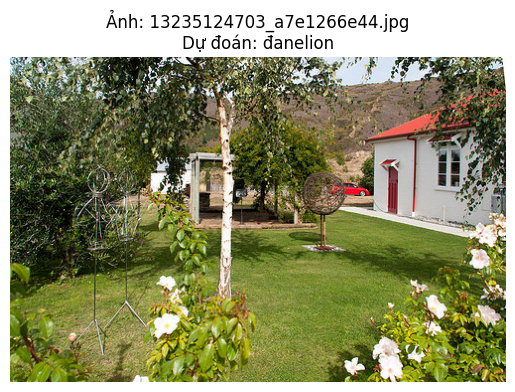

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


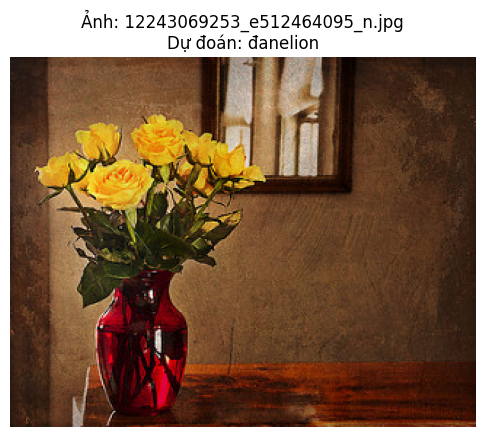

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


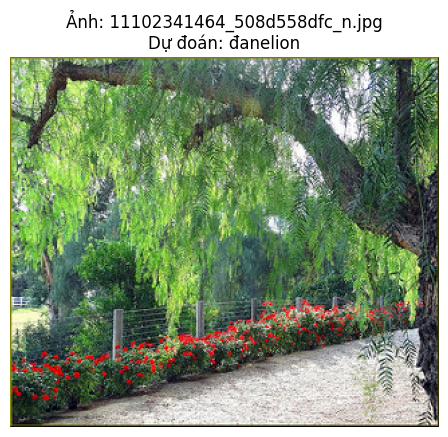

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


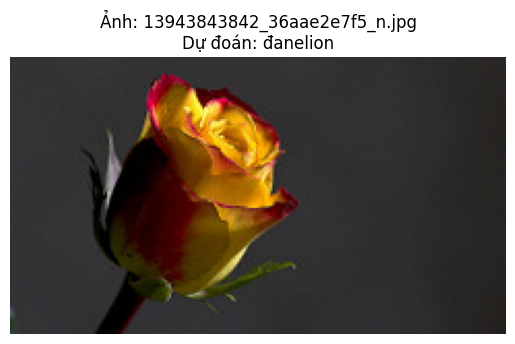

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


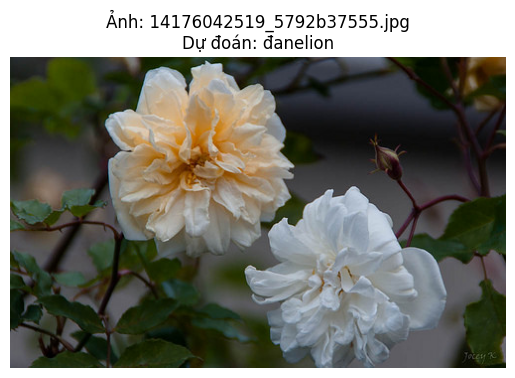

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


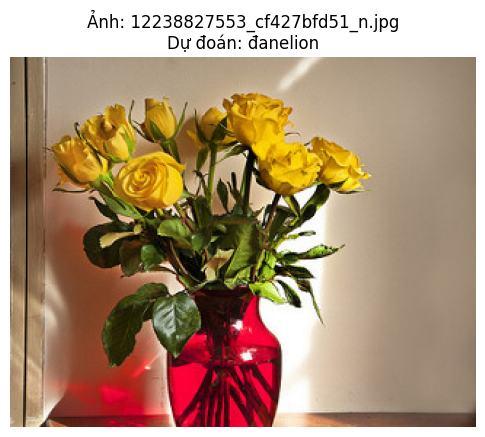

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


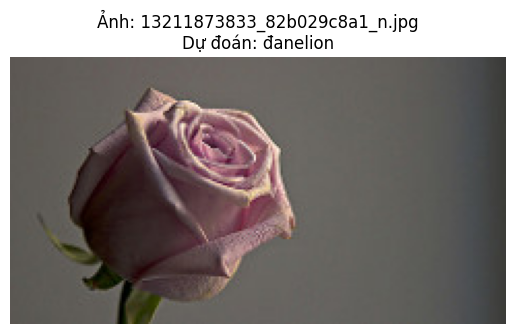

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


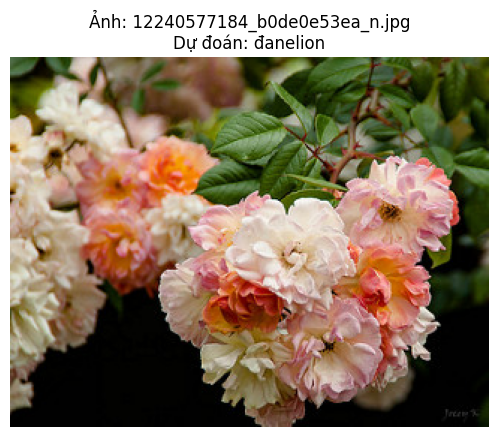

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


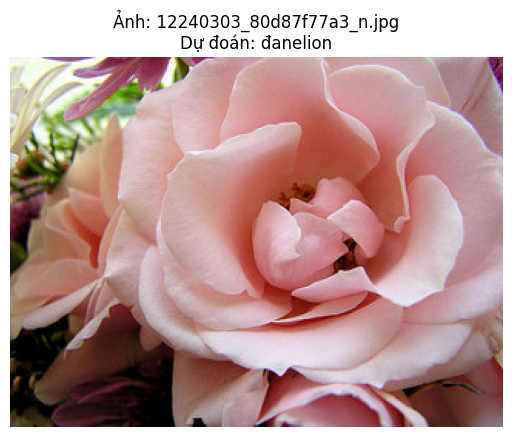

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


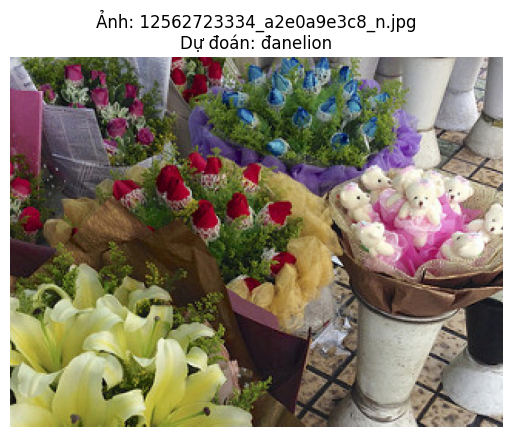

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


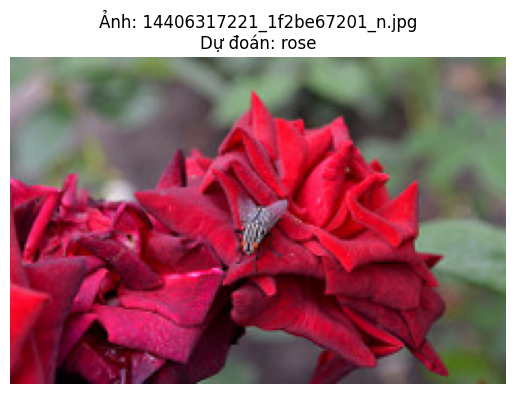

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


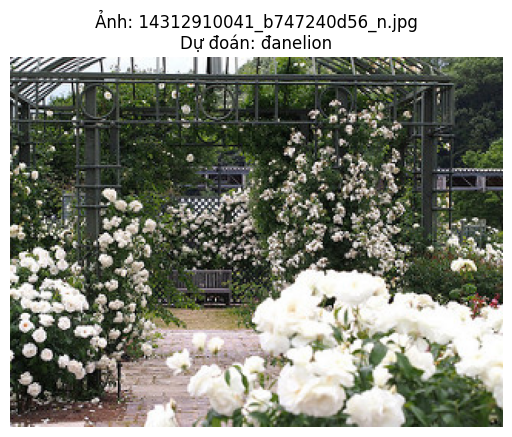

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


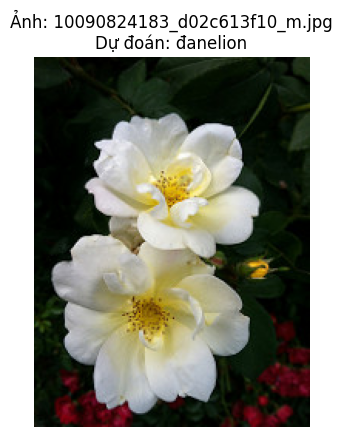

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


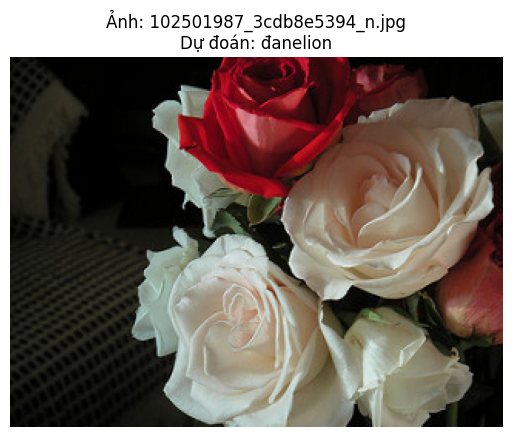

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


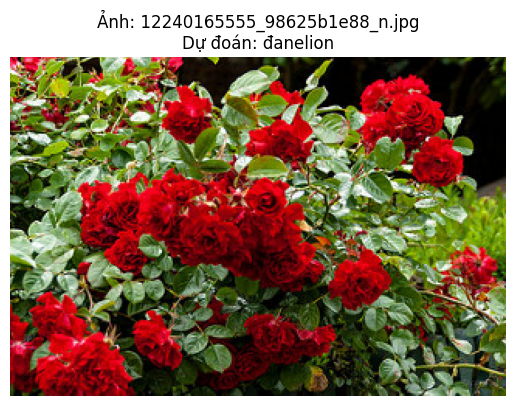

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


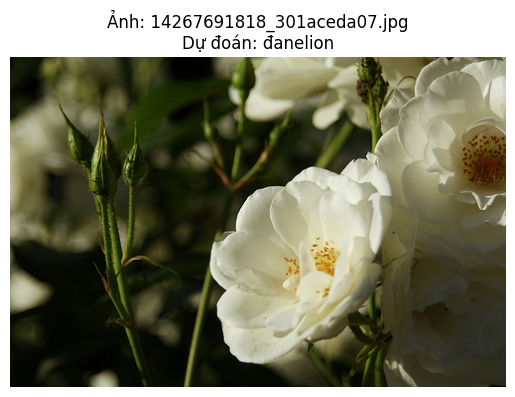

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


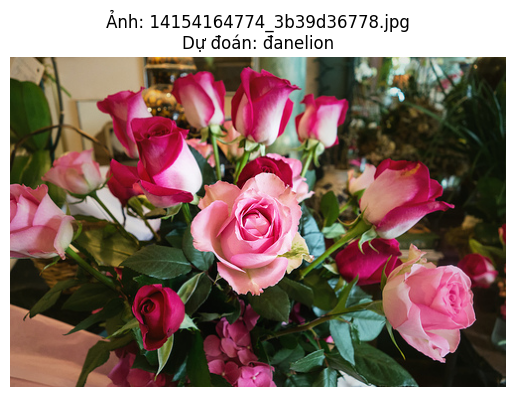

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


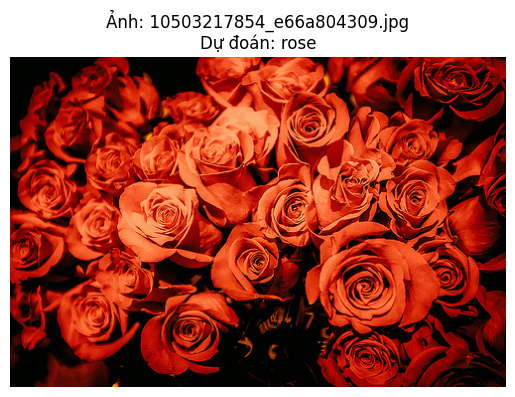

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


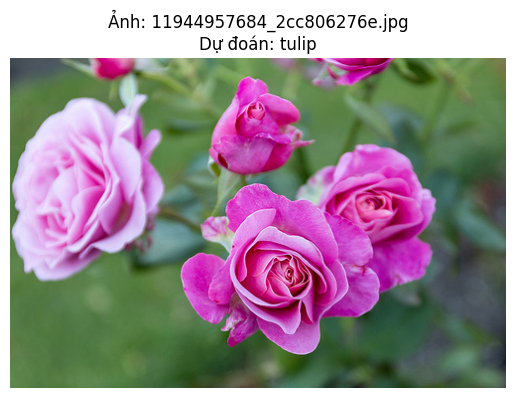

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


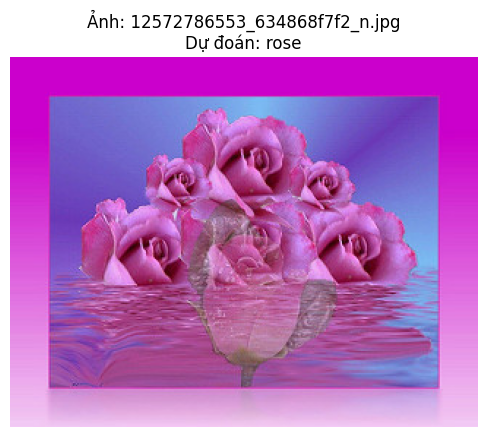

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


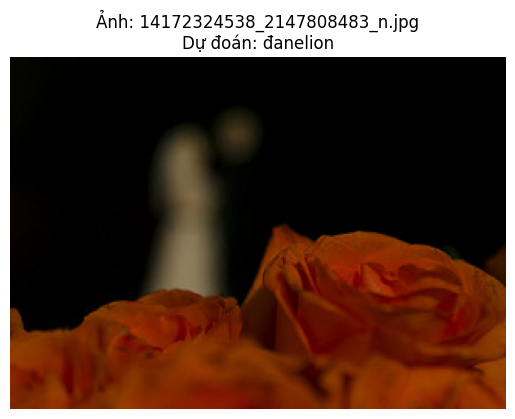

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


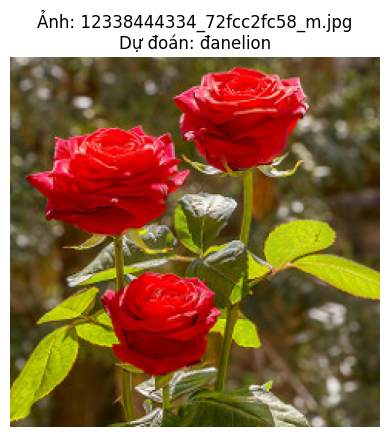

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


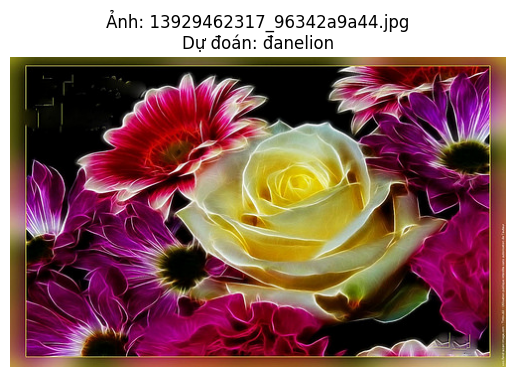

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


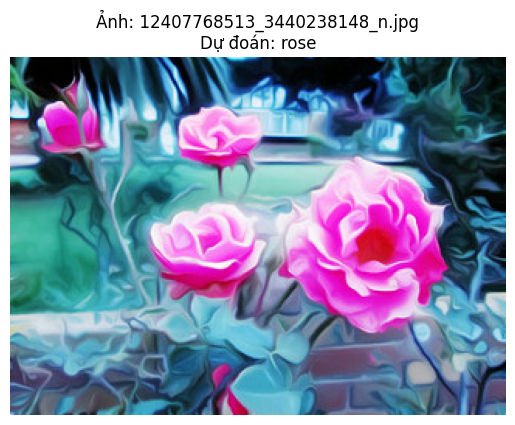

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


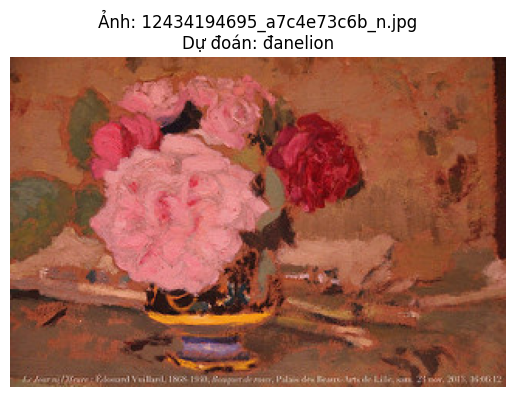

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


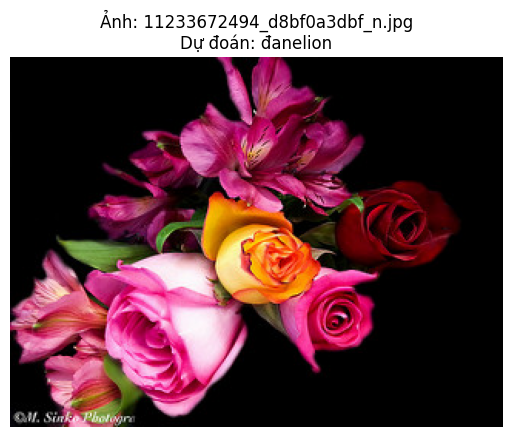

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


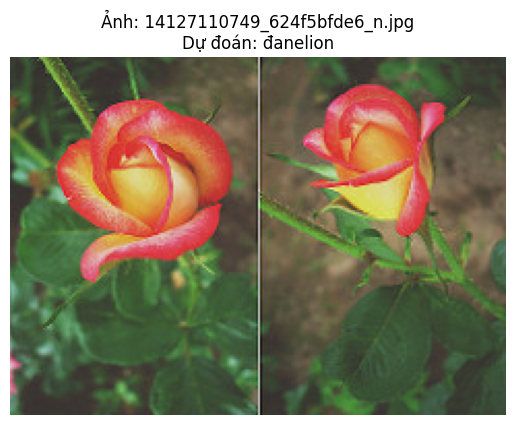

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


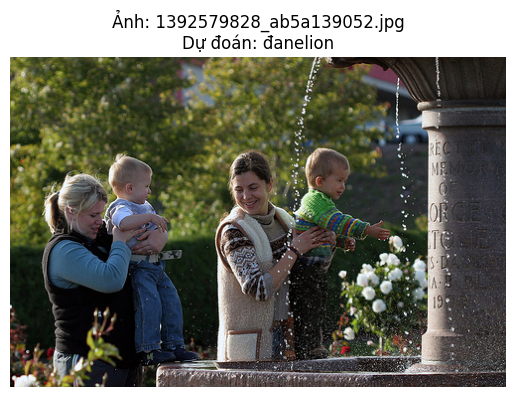

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


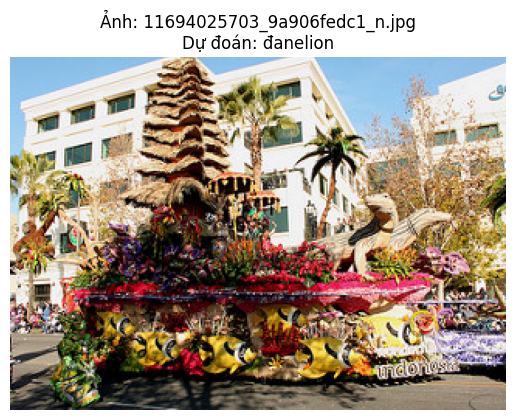

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


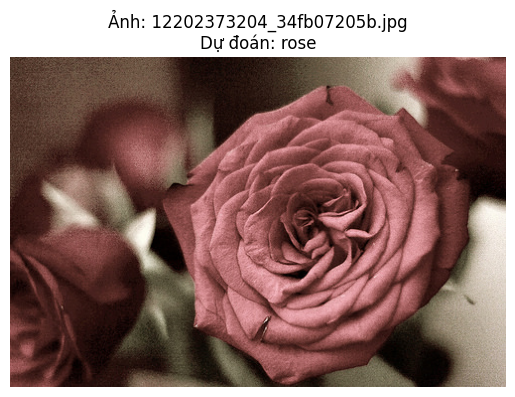

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


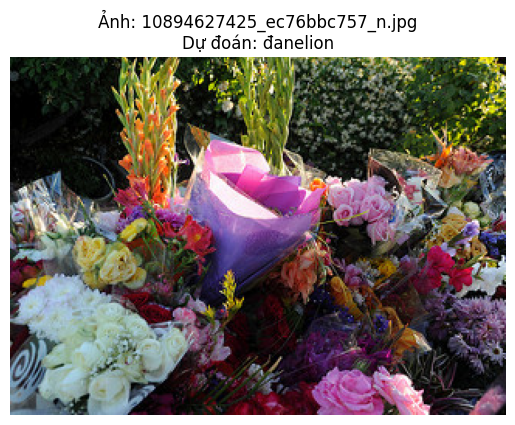

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


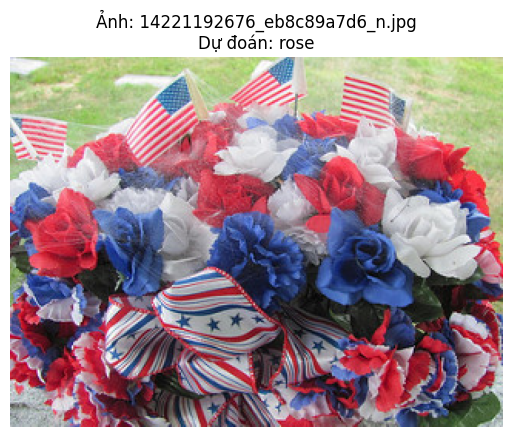

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


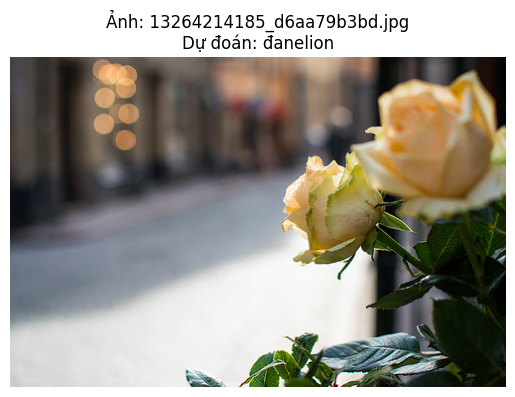

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


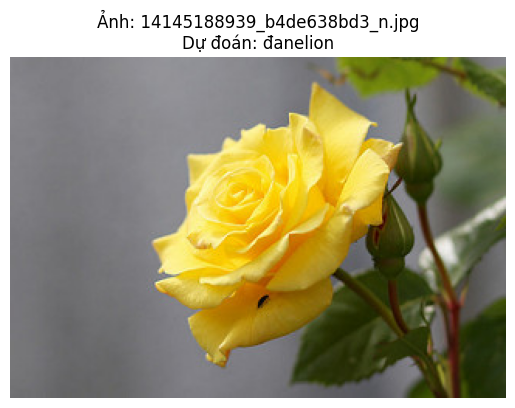

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


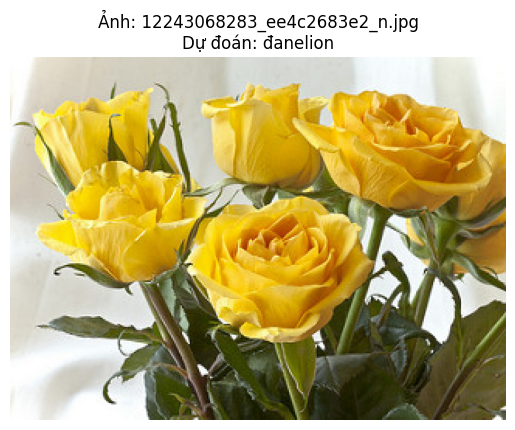

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


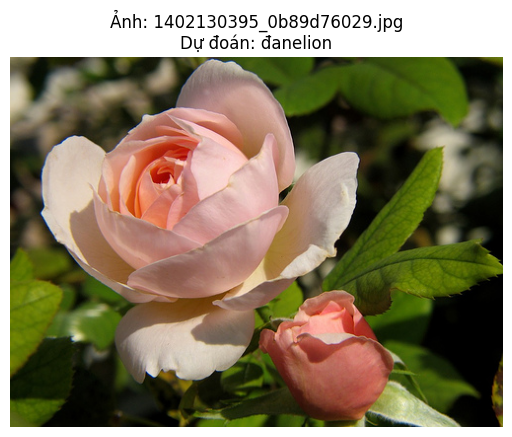

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


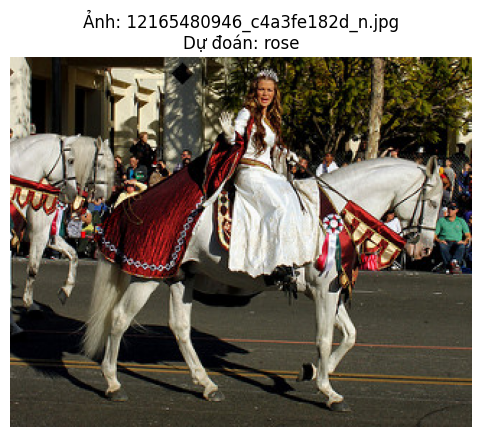

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


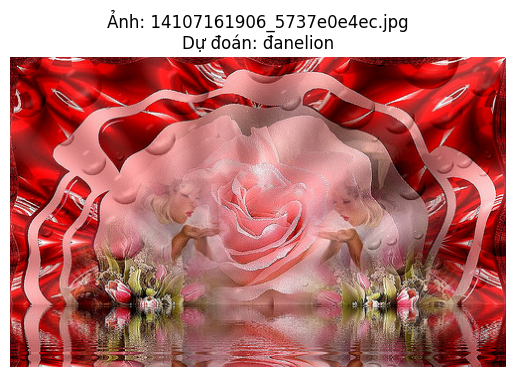

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


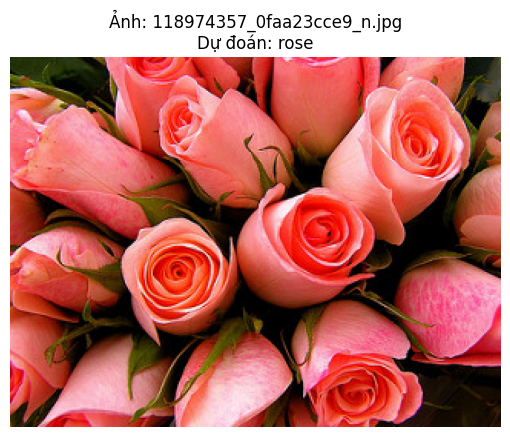

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


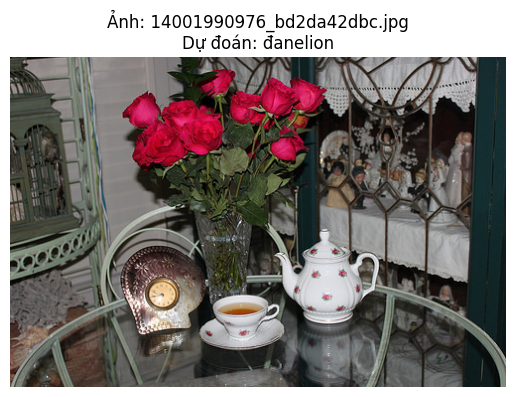

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


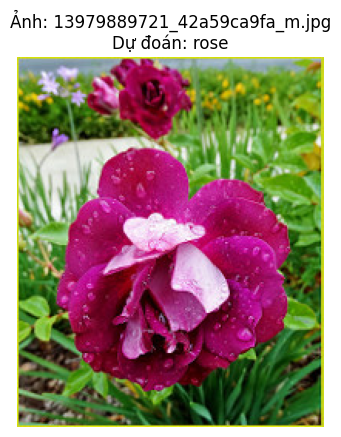

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


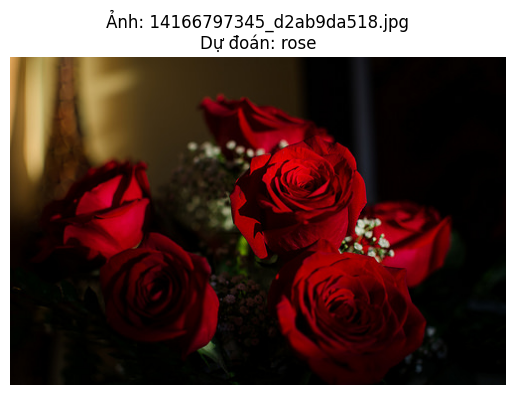

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


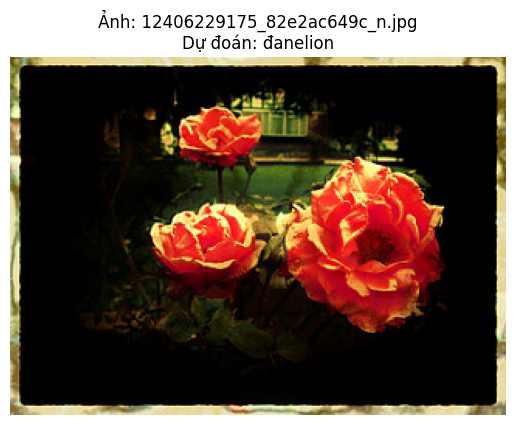

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


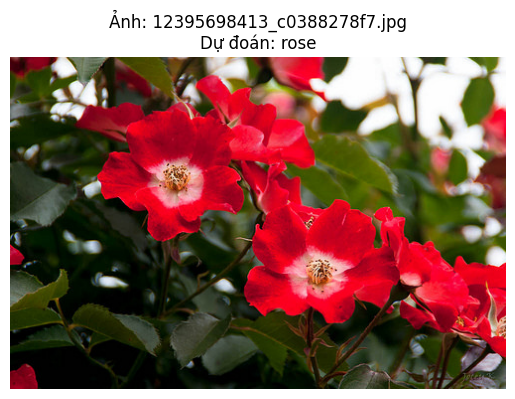

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


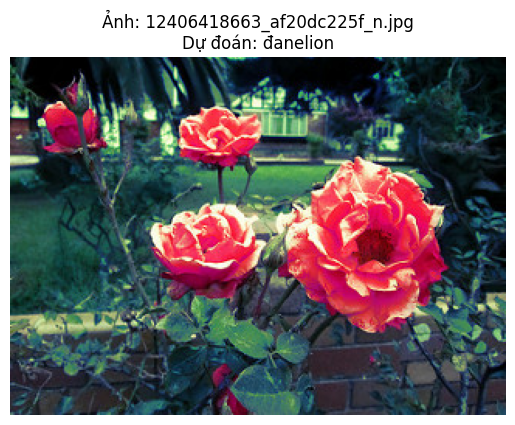

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


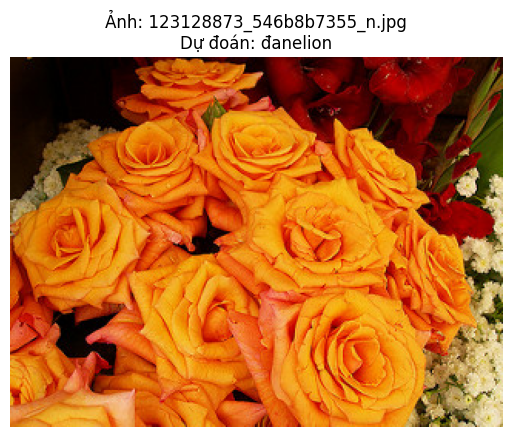

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


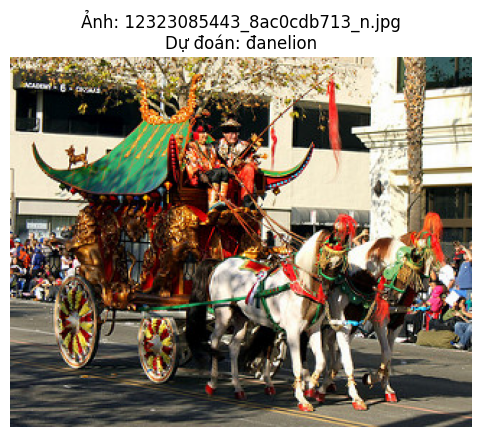

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


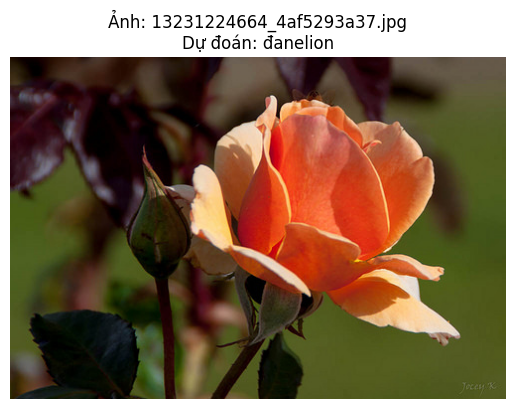

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


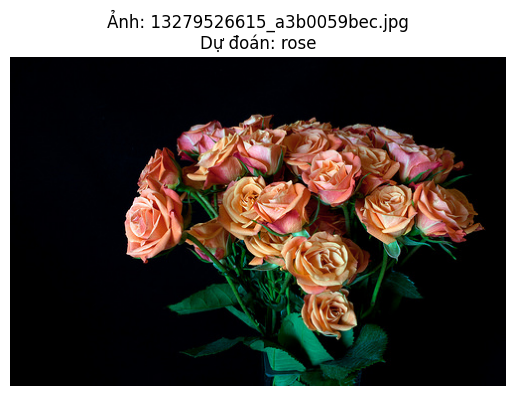

In [ ]:
from tensorflow.keras.models import load_model
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load mô hình đã huấn luyện
model = load_model("/content/hoadatrain.h5")

# Đường dẫn đến thư mục ảnh cần nhận diện
folder_path = "/content/drive/MyDrive/flowers/1"

# Kích thước ảnh giống lúc huấn luyện
img_size = (64, 64)

# Nhãn các lớp
labels = ['daisy', 'đanelion', 'rose', 'sunflower', 'tulip']

for file_name in os.listdir(folder_path):
    if file_name.lower().endswith((".jpg", ".jpeg", ".png")):
        img_path = os.path.join(folder_path, file_name)
        img = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # để hiển thị đúng màu
        img_resized = cv2.resize(img_rgb, img_size)
        img_input = img_resized.astype("float32") / 255
        img_input = img_input.reshape(1, 64*64*3)

        prediction = model.predict(img_input)
        predicted_label = labels[np.argmax(prediction)]

        # Hiển thị ảnh và nhãn dự đoán
        plt.imshow(img_rgb)
        plt.axis("off")
        plt.title(f"Ảnh: {file_name}\nDự đoán: {predicted_label}")
        plt.show()